# **0. CONNECT TO DRIVE**

In [323]:
from google.colab import drive

In [324]:
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


# **1. IMPORT LIBRARIES**

In [326]:
!pip install catboost

In [328]:
import sys
import warnings

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Library for acquiring data
import tweepy as tw

# Library for text preprocessing
import re
import string
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

# Library for manual labeling
from textblob import TextBlob
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Library for training preparation
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer

# Library for ML algorithm
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

# Library for model performance
from sklearn.metrics import make_scorer, confusion_matrix, classification_report, precision_score, recall_score, f1_score

# Library for generating wordcloud
from PIL import Image
from wordcloud import WordCloud, STOPWORDS

In [329]:
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('vader_lexicon')
warnings.filterwarnings('ignore')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [460]:
np.set_printoptions(threshold=sys.maxsize)
pd.set_option('display.max_colwidth', -1)
pd. set_option('display.max_rows', 600) 
sns.color_palette('Spectral')
sns.set_style('whitegrid')

In [343]:
stop_words = set(stopwords.words('english'))

# **2. DEFINE FUNCTION**

## **2.1. TWITTER ACCESS**

In [344]:
def twitter_access(twitter_account):

  consumer_api_key = twitter_account.loc[0,'Id']
  consumer_api_key_secret = twitter_account.loc[1,'Id']
  access_token = twitter_account.loc[2,'Id']
  access_token_secret = twitter_account.loc[3,'Id']

  return consumer_api_key, consumer_api_key_secret, access_token, access_token_secret

In [345]:
def twitter_api(consumer_api_key, consumer_api_key_secret, access_token, access_token_secret):

  authenticate = tw.OAuthHandler(consumer_api_key, consumer_api_key_secret)
  authenticate.set_access_token(access_token, access_token_secret)
  api = tw.API(authenticate)

  return api

## **2.2. TWEETS FETCHING**

In [346]:
def tweets_fetching(api, keyword, num_of_tweets, since_date=None, until_date=None):

  raw_tweets_list = []

  tweets = tw.Cursor(api.search, 
                     q=keyword+'-filter:retweets', 
                     lang='en',
                     since=since_date,
                     until=until_date, 
                     tweet_mode='extended').items(num_of_tweets)

  for tweet in tweets:
    raw_tweets_list.append(tweet.full_text)
  
  return raw_tweets_list  

## **2.3. TEXT CLEANING**

In [347]:
def text_cleaning(text):

  text = text.lower()
  text = text.replace('\n',' ') 
  text = re.sub(r'(@[A-Za-z0-9_]+)', '', text)
  text = re.sub(r'#[A-Za-z0-9_]+', '', text)
  text = re.sub(r'https?:\/\/\S*', '', text)
  text = re.sub(r"[^\w\d'\s]+",'', text)
  text = re.sub(r'[0-9]+', '',  text)
  text = re.sub(' +', ' ', text)
  text = text.strip()

  text = text.translate(str.maketrans('', '', string.punctuation))

  text_tokens = word_tokenize(text)
  filtered_words = [w for w in text_tokens if not w in stop_words]
    
  lemmatizer = WordNetLemmatizer()
  lemma_words = [lemmatizer.lemmatize(w, pos='a') for w in filtered_words]

  return " ".join(lemma_words)

## **2.4. SENTIMENT DETERMINATION**

In [348]:
def sentiment_determination(tweets_df):

  tweets_df[['polarity', 'subjectivity']] = tweets_df['clean'].apply(lambda Text: pd.Series(TextBlob(Text).sentiment))

  for index, row in tweets_df['clean'].iteritems():
    score = SentimentIntensityAnalyzer().polarity_scores(row)

    if score['neg'] > score['pos']:
      tweets_df.loc[index, 'sentiment'] = 'negative'
    elif score['pos'] > score['neg']:
      tweets_df.loc[index, 'sentiment'] = 'positive'
    else:
      tweets_df.loc[index, 'sentiment'] = 'neutral'

    tweets_df.loc[index, 'pos'] = score['pos']
    tweets_df.loc[index, 'neu'] = score['neu']
    tweets_df.loc[index, 'neg'] = score['neg']
    tweets_df.loc[index, 'compound'] = score['compound']

  return tweets_df

## **2.5. SENTIMENT ENCODING**

In [349]:
def encoded_class(class_string):

  if class_string == 'negative':
    enc_class = 0
  elif class_string == 'positive':
    enc_class = 1
  elif class_string == 'neutral':
    enc_class = 2

  return enc_class

## **2.6. TEXT VECTORIZING**

In [350]:
def text_vectorizer(X_train, X_test):

  tfidf_vectorizer = TfidfVectorizer(use_idf=True, ngram_range=(1,2))

  X_train_vectorizer = tfidf_vectorizer.fit_transform(X_train)
  X_test_vectorizer = tfidf_vectorizer.transform(X_test)

  return X_train_vectorizer, X_test_vectorizer

## **2.7. MODELING, CROSS VALIDATION, AND TRAINING**

In [446]:
def modeling_cv_training(model, X, y, cv=5):

  scorer = make_scorer(f1_score, average ='micro')

  cv_scores = cross_val_score(estimator=model, X=X, y=y, cv=cv, scoring=scorer)

  return np.mean(cv_scores)

## **2.8. MODEL EVALUATION**

In [382]:
def model_metrics(y_true, y_pred, model):

  print('Confusion matrix: \n', confusion_matrix(y_true, y_pred),'\n') # confusion matrix

  cm = confusion_matrix(y_true, y_pred, labels=model.classes_)
  sns.heatmap(cm, annot=True, fmt=".1f", cmap='cividis')

  print('Classification report: \n', classification_report(y_true, y_pred),'\n') # classification report
  print('Precision: {:0.2f}%'.format(round(precision_score(y_true, y_pred, average='micro'), 4)*100)) # precision
  print('Recall: {:0.2f}%'.format(round(recall_score(y_true, y_pred, average='micro'), 4)*100)) # recall
  print('F1-Score: {:0.2f}%'.format(round(f1_score(y_true, y_pred, average='micro'), 4)*100)) # f1-score

## **2.9. WORDCLOUD**

In [496]:
def wordcloud(tweets_df):
  
  mask = np.array(Image.open('awan.png'))
  stopwords = STOPWORDS

  wc = WordCloud(width=1600, height=800,
                  background_color='white',
                  mask = mask,
                  stopwords=stopwords,
                  repeat=True)
  
  word = wc.generate(str(''.join(tweets_df['clean'])))

  plt.imshow(word, interpolation='bilinear')
  plt.axis('off')
  plt.show()

# **3. IMPLEMENTATION**

## **3.1. SET UP TWITTER API ACCESS**

In [354]:
twitter_account = pd.read_csv('/content/drive/MyDrive/Sentiment Analysis/Twitter Developer Account.csv')

In [355]:
consumer_api_key, consumer_api_key_secret, access_token, access_token_secret = twitter_access(twitter_account)

In [356]:
api = twitter_api(consumer_api_key, consumer_api_key_secret, access_token, access_token_secret)

## **3.2. FETCH TWEETS**

In [357]:
raw_tweets_list = tweets_fetching(api, 'Astroworld AND Travis Scott', 500, since_date='2021-11-07')
raw_tweets_list

["Just want to send my condolences to all those that lost their life at astroworld (Travis Scott's concert)\n#rip",
 'Travis Scott Astroworld Stage Finally Torn Down, Weeks After Deadly Concert https://t.co/Hbq4N4FJCU',
 'guys astroworld is a demonic ritual and he was summoning demons and the devil and at the concert he tried to sacrifice to the devil and it worked so i won’t be listening to travis scott anymore sorry',
 'I’m still flabbergasted at Travis Scott choosing a person whos brand originated from having an extreme lack of empathy for his interview about the Astroworld situation.',
 'Also in 2017, Travis Scott goaded a fan to leap from a second-floor balcony at New York’s Terminal 5.\n\n“I see you, but are you gonna do it?” Scott said. “They gonna catch you, don’t be scared! Fall!”\n\nThe fan ended up breaking both of his legs.\nhttps://t.co/LiphHc3Zuk 02',
 'Astroworld Festival Victims File $10 Billion Lawsuit Against Travis Scott https://t.co/lIQ6NZgOqm',
 'CREEP!! \u2066@trv

In [358]:
tweets_df = pd.DataFrame({
    'raw' : raw_tweets_list
})

In [359]:
tweets_df

,raw
0,Just want to send my condolences to all those that lost their life at astroworld (Travis Scott's concert)\n#rip
1,"Travis Scott Astroworld Stage Finally Torn Down, Weeks After Deadly Concert https://t.co/Hbq4N4FJCU"
2,guys astroworld is a demonic ritual and he was summoning demons and the devil and at the concert he tried to sacrifice to the devil and it worked so i won’t be listening to travis scott anymore sorry
3,I’m still flabbergasted at Travis Scott choosing a person whos brand originated from having an extreme lack of empathy for his interview about the Astroworld situation.
4,"Also in 2017, Travis Scott goaded a fan to leap from a second-floor balcony at New York’s Terminal 5.\n\n“I see you, but are you gonna do it?” Scott said. “They gonna catch you, don’t be scared! Fall!”\n\nThe fan ended up breaking both of his legs.\nhttps://t.co/LiphHc3Zuk 02"
5,Astroworld Festival Victims File $10 Billion Lawsuit Against Travis Scott https://t.co/lIQ6NZgOqm
6,CREEP!! ⁦@trvisXX⁩ is a LOSER and should pay hard for all of it. #astroworld \n\nTravis Scott Won’t Be Covering Youngest Astroworld Victim’s Funeral – Rolling Stone https://t.co/fKZcHaTQIV
7,"#YTB #DED #RUS \nLive Nation, Apple and Travis Scott were sued for $2 billion by hundreds of people who say they were injured at the deadly Astroworld concert earlier this month https://t.co/VIzez70y7Z"
8,Life sucks cuz I’ll never be able to relive the first time I ever heard drugs you should try it for the first time in 2014. Before Travis blew up before all the bullshit at astroworld fest before the Kylie Jenner and Travis Scott meal bullshit. Truly hate it here
9,"@hayrae8o8 The whole demons thing from astroworld is bad. Blaming demons instead of Travis Scott for his negligence is harmful to the victims of astroworld, it shifts the blame to something else and he needs to be accountable for his actions."


In [360]:
tweets_df.to_csv('/content/drive/MyDrive/Sentiment Analysis/Dataset/raw_tweet.csv', header=True, index=False)

## **3.3. DATA CLEANING**

In [361]:
loaded_tweets = pd.read_csv('/content/drive/MyDrive/Sentiment Analysis/Dataset/raw_tweet.csv')

In [362]:
loaded_tweets['clean'] = loaded_tweets['raw'].apply(lambda x: text_cleaning(x))

In [363]:
loaded_tweets

,raw,clean
0,Just want to send my condolences to all those that lost their life at astroworld (Travis Scott's concert)\n#rip,want send condolences lost life astroworld travis scotts concert
1,"Travis Scott Astroworld Stage Finally Torn Down, Weeks After Deadly Concert https://t.co/Hbq4N4FJCU",travis scott astroworld stage finally torn weeks deadly concert
2,guys astroworld is a demonic ritual and he was summoning demons and the devil and at the concert he tried to sacrifice to the devil and it worked so i won’t be listening to travis scott anymore sorry,guys astroworld demonic ritual summoning demons devil concert tried sacrifice devil worked wont listening travis scott anymore sorry
3,I’m still flabbergasted at Travis Scott choosing a person whos brand originated from having an extreme lack of empathy for his interview about the Astroworld situation.,im still flabbergasted travis scott choosing person whos brand originated extreme lack empathy interview astroworld situation
4,"Also in 2017, Travis Scott goaded a fan to leap from a second-floor balcony at New York’s Terminal 5.\n\n“I see you, but are you gonna do it?” Scott said. “They gonna catch you, don’t be scared! Fall!”\n\nThe fan ended up breaking both of his legs.\nhttps://t.co/LiphHc3Zuk 02",also travis scott goaded fan leap secondfloor balcony new yorks terminal see gon na scott said gon na catch dont scared fall fan ended breaking legs
5,Astroworld Festival Victims File $10 Billion Lawsuit Against Travis Scott https://t.co/lIQ6NZgOqm,astroworld festival victims file billion lawsuit travis scott
6,CREEP!! ⁦@trvisXX⁩ is a LOSER and should pay hard for all of it. #astroworld \n\nTravis Scott Won’t Be Covering Youngest Astroworld Victim’s Funeral – Rolling Stone https://t.co/fKZcHaTQIV,creep loser pay hard travis scott wont covering young astroworld victims funeral rolling stone
7,"#YTB #DED #RUS \nLive Nation, Apple and Travis Scott were sued for $2 billion by hundreds of people who say they were injured at the deadly Astroworld concert earlier this month https://t.co/VIzez70y7Z",live nation apple travis scott sued billion hundreds people say injured deadly astroworld concert early month
8,Life sucks cuz I’ll never be able to relive the first time I ever heard drugs you should try it for the first time in 2014. Before Travis blew up before all the bullshit at astroworld fest before the Kylie Jenner and Travis Scott meal bullshit. Truly hate it here,life sucks cuz ill never able relive first time ever heard drugs try first time travis blew bullshit astroworld fest kylie jenner travis scott meal bullshit truly hate
9,"@hayrae8o8 The whole demons thing from astroworld is bad. Blaming demons instead of Travis Scott for his negligence is harmful to the victims of astroworld, it shifts the blame to something else and he needs to be accountable for his actions.",whole demons thing astroworld bad blaming demons instead travis scott negligence harmful victims astroworld shifts blame something else needs accountable actions


In [364]:
tweets_no_duplicate = loaded_tweets.drop_duplicates(subset='clean')

In [365]:
tweets_no_duplicate.shape

(308, 2)

## **3.4. MANUAL LABELING**

In [366]:
tweets_df = sentiment_determination(tweets_no_duplicate)

In [367]:
tweets_df

,raw,clean,polarity,subjectivity,sentiment,pos,neu,neg,compound
0,Just want to send my condolences to all those that lost their life at astroworld (Travis Scott's concert)\n#rip,want send condolences lost life astroworld travis scotts concert,0.000000e+00,0.000000,negative,0.123,0.660,0.217,-0.2500
1,"Travis Scott Astroworld Stage Finally Torn Down, Weeks After Deadly Concert https://t.co/Hbq4N4FJCU",travis scott astroworld stage finally torn weeks deadly concert,-1.000000e-01,0.700000,negative,0.000,0.800,0.200,-0.2500
2,guys astroworld is a demonic ritual and he was summoning demons and the devil and at the concert he tried to sacrifice to the devil and it worked so i won’t be listening to travis scott anymore sorry,guys astroworld demonic ritual summoning demons devil concert tried sacrifice devil worked wont listening travis scott anymore sorry,-5.000000e-01,1.000000,negative,0.000,0.598,0.402,-0.8779
3,I’m still flabbergasted at Travis Scott choosing a person whos brand originated from having an extreme lack of empathy for his interview about the Astroworld situation.,im still flabbergasted travis scott choosing person whos brand originated extreme lack empathy interview astroworld situation,-1.250000e-01,1.000000,negative,0.000,0.867,0.133,-0.3182
4,"Also in 2017, Travis Scott goaded a fan to leap from a second-floor balcony at New York’s Terminal 5.\n\n“I see you, but are you gonna do it?” Scott said. “They gonna catch you, don’t be scared! Fall!”\n\nThe fan ended up breaking both of his legs.\nhttps://t.co/LiphHc3Zuk 02",also travis scott goaded fan leap secondfloor balcony new yorks terminal see gon na scott said gon na catch dont scared fall fan ended breaking legs,1.363636e-01,0.454545,positive,0.233,0.767,0.000,0.7189
5,Astroworld Festival Victims File $10 Billion Lawsuit Against Travis Scott https://t.co/lIQ6NZgOqm,astroworld festival victims file billion lawsuit travis scott,0.000000e+00,0.000000,negative,0.258,0.403,0.339,0.0000
6,CREEP!! ⁦@trvisXX⁩ is a LOSER and should pay hard for all of it. #astroworld \n\nTravis Scott Won’t Be Covering Youngest Astroworld Victim’s Funeral – Rolling Stone https://t.co/fKZcHaTQIV,creep loser pay hard travis scott wont covering young astroworld victims funeral rolling stone,-9.583333e-02,0.470833,negative,0.000,0.450,0.550,-0.8402
7,"#YTB #DED #RUS \nLive Nation, Apple and Travis Scott were sued for $2 billion by hundreds of people who say they were injured at the deadly Astroworld concert earlier this month https://t.co/VIzez70y7Z",live nation apple travis scott sued billion hundreds people say injured deadly astroworld concert early month,1.212121e-02,0.400000,negative,0.000,0.847,0.153,-0.4019
8,Life sucks cuz I’ll never be able to relive the first time I ever heard drugs you should try it for the first time in 2014. Before Travis blew up before all the bullshit at astroworld fest before the Kylie Jenner and Travis Scott meal bullshit. Truly hate it here,life sucks cuz ill never able relive first time ever heard drugs try first time travis blew bullshit astroworld fest kylie jenner travis scott meal bullshit truly hate,-2.250000e-01,0.581944,negative,0.070,0.530,0.400,-0.9287
9,"@hayrae8o8 The whole demons thing from astroworld is bad. Blaming demons instead of Travis Scott for his negligence is harmful to the victims of astroworld, it shifts the blame to something else and he needs to be accountable for his actions.",whole demons thing astroworld bad blaming demons instead travis scott negligence harmful victims astroworld shifts blame something else needs accountable actions,-2.500000e-01,0.533333,negative,0.000,0.599,0.401,-0.8860


In [368]:
tweets_df['sentiment'].value_counts()

negative    184
positive    75 
neutral     49 
Name: sentiment, dtype: int64

Text(0, 0.5, '')

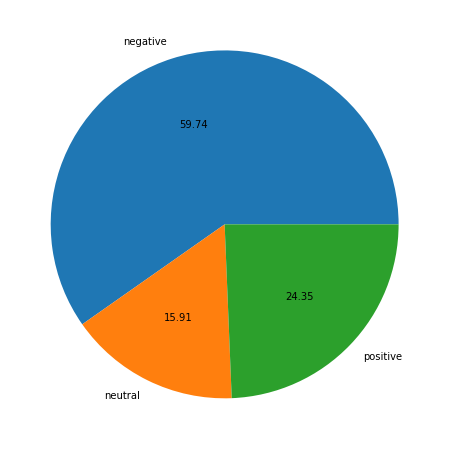

In [369]:
fig, ax = plt.subplots(figsize=(8,8))
tweets_df.groupby('sentiment').size().plot(kind='pie', autopct='%.2f')
ax.set_ylabel('', size=22)

In [370]:
tweets_df = tweets_df[['raw','clean','polarity','subjectivity','pos','neu','neg','compound','sentiment']]

In [371]:
tweets_df['encoded_sentiment'] = tweets_df['sentiment'].apply(lambda x: encoded_class(x))

In [372]:
tweets_df['encoded_sentiment'].value_counts()

0    184
1    75 
2    49 
Name: encoded_sentiment, dtype: int64

## **3.5. FEATURE VECTOR**

In [373]:
X = tweets_df['clean']
y = tweets_df['encoded_sentiment']

In [374]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=2021)

In [375]:
training = pd.DataFrame({
    'text' : X_train,
    'sentiment' : y_train
})

training

,text,sentiment
203,travis scott fallout continues astroworld rapper booted coachella lineup getty,2
381,years astroworld tragedy travis scott told sf crowd good see bodies air,0
272,someone said first year old died astroworld said travis scott arrested,0
24,poor travis scottyou know clock ticking kyle bout break,0
489,act surprised people got hurt even killed show perplexing,0
89,travis scott astroworld stage finally torn weeks deadly concert viu hapa,0
209,reminder people still buying tickets shows put live nation travis scott two products releases canceled dropped coachella offering perform free outrage astroworld looking yt,2
137,kylie jenner celebrates baby shower amid travis scotts astroworld tragedy,0
454,travis scott long headline following astroworld tragedy last month,0
415,weeks silence travis scott finally sat talk astroworld disaster read late news article malachi mitchell follow link,0


In [376]:
y_train.value_counts()

0    163
1    66 
2    48 
Name: encoded_sentiment, dtype: int64

In [377]:
test = pd.DataFrame({
    'text' : X_test,
    'sentiment' : y_test
})

test

,text,sentiment
306,isnt disgruntled travis scott showed us navy ship getting blown astroworld san diego guess also disgruntled really think kid capable wow,1
224,long headlining annual music festival,1
369,christmas miracle byeeeeee travis scott long performing coachella astroworld replaced new punk band vindicated kook,1
46,travis scott drake apple live nation facing new billion astroworld lawsuit via,0
367,im sorry still never understand astroworld deaths travis scotts fault like really got ta tell,0
204,wake numerous lawsuits following astroworld tragedy travis scott dropped coachella lineup hard seltzer cacti discontinued,0
290,travis scott sacrificial ritual truth via astroworld performance goes much deep meets eye relating portal openings deity channeling child sacrifice,1
125,travis scott cancelled rapper thrown coachella lineup astroworld tragedy,0
481,travis scott reportedly removed coachella lineup astroworld tragedy,0
171,travis scotts cacti spiked seltzer discontinued astroworld disaster,0


In [378]:
y_test.value_counts()

0    21
1    9 
2    1 
Name: encoded_sentiment, dtype: int64

In [379]:
X_train_vectorizer, X_test_vectorizer = text_vectorizer(X_train, X_test)

In [271]:
X_train_vectorizer.toarray()

array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.14314594, 0.14314594, 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.  

In [380]:
X_test_vectorizer.toarray()

array([[0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.3157941 , 0.        , 0.        , 0.  

## **3.6. MODELING, CROSS VALIDATION, AND TRAINING**

### **3.6.1. MULTINOMIAL NB**

In [383]:
multinomial_nb = MultinomialNB()

In [447]:
# cross_val_score

cv_score_1 = modeling_cv_training(multinomial_nb, X_train_vectorizer, y_train)
cv_score_1

0.5885064935064934

In [385]:
multinomial_nb.fit(X_train_vectorizer, y_train)

MultinomialNB()

### **3.6.2 GAUSSIAN NB**

In [388]:
gaussian_nb = GaussianNB()

In [448]:
# cross_val_score

cv_score_2 = modeling_cv_training(gaussian_nb, X_train_vectorizer.todense(), y_train)
cv_score_2

0.6601298701298701

In [394]:
gaussian_nb.fit(X_train_vectorizer.todense(), y_train)

GaussianNB()

### **3.6.3. RANDOM FOREST**

In [391]:
rf = RandomForestClassifier(random_state=42)

In [449]:
# cross_val_score

cv_score_3 = modeling_cv_training(rf, X_train_vectorizer, y_train)
cv_score_3

0.6174675324675325

In [395]:
rf.fit(X_train_vectorizer, y_train)

RandomForestClassifier(random_state=42)

### **3.6.4. ADABOOST**

In [396]:
ada = AdaBoostClassifier(random_state=42)

In [450]:
# cross_val_score

cv_score_4 = modeling_cv_training(ada, X_train_vectorizer, y_train)
cv_score_4

0.5775974025974026

In [398]:
ada.fit(X_train_vectorizer, y_train)

AdaBoostClassifier(random_state=42)

### **3.6.5. LGBM**

In [399]:
lgbm = LGBMClassifier()

In [451]:
# cross_val_score

cv_score_5 = modeling_cv_training(lgbm, X_train_vectorizer, y_train)
cv_score_5

0.6212337662337661

In [401]:
lgbm.fit(X_train_vectorizer, y_train)

LGBMClassifier()

### **3.5.6. XGBOOST**

In [402]:
xgb = XGBClassifier()

In [452]:
# cross_val_score

cv_score_6 = modeling_cv_training(xgb, X_train_vectorizer, y_train)
cv_score_6

0.6862987012987014

In [405]:
xgb.fit(X_train_vectorizer, y_train)

XGBClassifier(objective='multi:softprob')

### **3.5.7. CATBOOST**

In [406]:
cb = CatBoostClassifier()

In [453]:
# cross_val_score

cv_score_7 = modeling_cv_training(cb, X_train_vectorizer, y_train)
cv_score_7

Streaming output truncated to the last 5000 lines.
4:	learn: 0.9940946	total: 130ms	remaining: 25.9s
5:	learn: 0.9779433	total: 154ms	remaining: 25.6s
6:	learn: 0.9638761	total: 180ms	remaining: 25.5s
7:	learn: 0.9541847	total: 235ms	remaining: 29.1s
8:	learn: 0.9416142	total: 259ms	remaining: 28.6s
9:	learn: 0.9268368	total: 287ms	remaining: 28.4s
10:	learn: 0.9187466	total: 313ms	remaining: 28.1s
11:	learn: 0.9058466	total: 337ms	remaining: 27.8s
12:	learn: 0.8993812	total: 363ms	remaining: 27.6s
13:	learn: 0.8935167	total: 387ms	remaining: 27.2s
14:	learn: 0.8857194	total: 414ms	remaining: 27.2s
15:	learn: 0.8785449	total: 442ms	remaining: 27.2s
16:	learn: 0.8717394	total: 468ms	remaining: 27s
17:	learn: 0.8658390	total: 492ms	remaining: 26.9s
18:	learn: 0.8543321	total: 517ms	remaining: 26.7s
19:	learn: 0.8508783	total: 541ms	remaining: 26.5s
20:	learn: 0.8420002	total: 565ms	remaining: 26.4s
21:	learn: 0.8385937	total: 590ms	remaining: 26.2s
22:	learn: 0.8363880	total: 616ms	remai

0.7044155844155845

In [408]:
cb.fit(X_train_vectorizer, y_train)

Learning rate set to 0.074112
0:	learn: 1.0709875	total: 82.1ms	remaining: 1m 22s
1:	learn: 1.0423237	total: 142ms	remaining: 1m 10s
2:	learn: 1.0251251	total: 203ms	remaining: 1m 7s
3:	learn: 1.0011970	total: 263ms	remaining: 1m 5s
4:	learn: 0.9842118	total: 326ms	remaining: 1m 4s
5:	learn: 0.9716647	total: 391ms	remaining: 1m 4s
6:	learn: 0.9573804	total: 451ms	remaining: 1m 3s
7:	learn: 0.9471120	total: 489ms	remaining: 1m
8:	learn: 0.9398535	total: 552ms	remaining: 1m
9:	learn: 0.9221945	total: 610ms	remaining: 1m
10:	learn: 0.9086414	total: 664ms	remaining: 59.7s
11:	learn: 0.9037103	total: 703ms	remaining: 57.9s
12:	learn: 0.8962227	total: 757ms	remaining: 57.5s
13:	learn: 0.8867887	total: 809ms	remaining: 57s
14:	learn: 0.8790001	total: 876ms	remaining: 57.5s
15:	learn: 0.8702232	total: 943ms	remaining: 58s
16:	learn: 0.8585464	total: 1s	remaining: 57.8s
17:	learn: 0.8554062	total: 1.06s	remaining: 57.7s
18:	learn: 0.8497327	total: 1.12s	remaining: 57.8s
19:	learn: 0.8424385	tot

## **3.7. TESTING AND MODEL METRICS**

### **3.7.1. MULTINOMIAL NB**

Confusion matrix: 
 [[21  0  0]
 [ 9  0  0]
 [ 1  0  0]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.68      1.00      0.81        21
           1       0.00      0.00      0.00         9
           2       0.00      0.00      0.00         1

    accuracy                           0.68        31
   macro avg       0.23      0.33      0.27        31
weighted avg       0.46      0.68      0.55        31
 

Precision: 67.74%
Recall: 67.74%
F1-Score: 67.74%


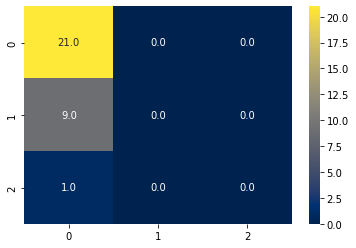

In [409]:
model_metrics(y_test, multinomial_nb.predict(X_test_vectorizer), multinomial_nb)

### **3.7.2. GAUSSIAN NB**

Confusion matrix: 
 [[20  1  0]
 [ 5  4  0]
 [ 1  0  0]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.77      0.95      0.85        21
           1       0.80      0.44      0.57         9
           2       0.00      0.00      0.00         1

    accuracy                           0.77        31
   macro avg       0.52      0.47      0.47        31
weighted avg       0.75      0.77      0.74        31
 

Precision: 77.42%
Recall: 77.42%
F1-Score: 77.42%


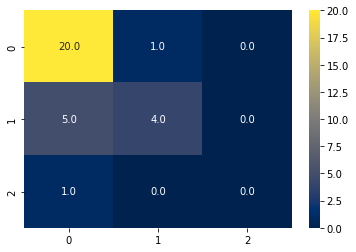

In [410]:
model_metrics(y_test, gaussian_nb.predict(X_test_vectorizer.todense()), gaussian_nb)

### **3.7.3. RANDOM FOREST**

Confusion matrix: 
 [[19  0  2]
 [ 4  0  5]
 [ 0  0  1]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.83      0.90      0.86        21
           1       0.00      0.00      0.00         9
           2       0.12      1.00      0.22         1

    accuracy                           0.65        31
   macro avg       0.32      0.63      0.36        31
weighted avg       0.56      0.65      0.59        31
 

Precision: 64.52%
Recall: 64.52%
F1-Score: 64.52%


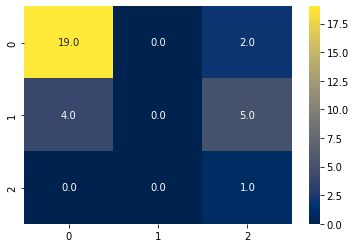

In [411]:
model_metrics(y_test, rf.predict(X_test_vectorizer), rf)

### **3.7.4. ADABOOST**

Confusion matrix: 
 [[14  2  5]
 [ 7  0  2]
 [ 0  0  1]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.67      0.67      0.67        21
           1       0.00      0.00      0.00         9
           2       0.12      1.00      0.22         1

    accuracy                           0.48        31
   macro avg       0.26      0.56      0.30        31
weighted avg       0.46      0.48      0.46        31
 

Precision: 48.39%
Recall: 48.39%
F1-Score: 48.39%


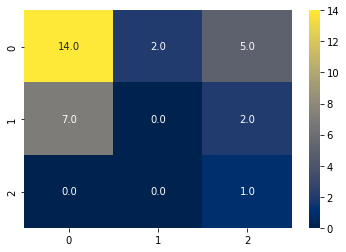

In [412]:
model_metrics(y_test, ada.predict(X_test_vectorizer), ada)

### **3.7.5. LGBM**

Confusion matrix: 
 [[16  0  5]
 [ 4  1  4]
 [ 1  0  0]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.76      0.76      0.76        21
           1       1.00      0.11      0.20         9
           2       0.00      0.00      0.00         1

    accuracy                           0.55        31
   macro avg       0.59      0.29      0.32        31
weighted avg       0.81      0.55      0.57        31
 

Precision: 54.84%
Recall: 54.84%
F1-Score: 54.84%


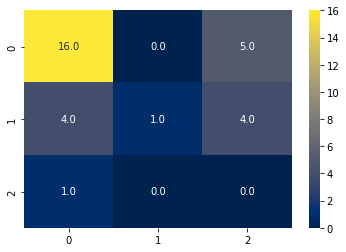

In [413]:
model_metrics(y_test, lgbm.predict(X_test_vectorizer), lgbm)

### **3.7.6. XGBOOST**

Confusion matrix: 
 [[16  0  5]
 [ 4  0  5]
 [ 0  0  1]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.80      0.76      0.78        21
           1       0.00      0.00      0.00         9
           2       0.09      1.00      0.17         1

    accuracy                           0.55        31
   macro avg       0.30      0.59      0.32        31
weighted avg       0.54      0.55      0.53        31
 

Precision: 54.84%
Recall: 54.84%
F1-Score: 54.84%


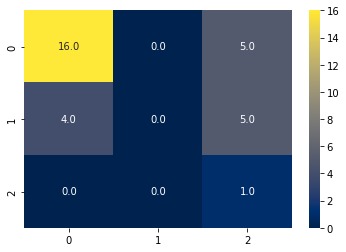

In [414]:
model_metrics(y_test, xgb.predict(X_test_vectorizer), xgb)

### **3.7.7. CATBOOST**

Confusion matrix: 
 [[18  0  3]
 [ 4  2  3]
 [ 0  0  1]] 

Classification report: 
               precision    recall  f1-score   support

           0       0.82      0.86      0.84        21
           1       1.00      0.22      0.36         9
           2       0.14      1.00      0.25         1

    accuracy                           0.68        31
   macro avg       0.65      0.69      0.48        31
weighted avg       0.85      0.68      0.68        31
 

Precision: 67.74%
Recall: 67.74%
F1-Score: 67.74%


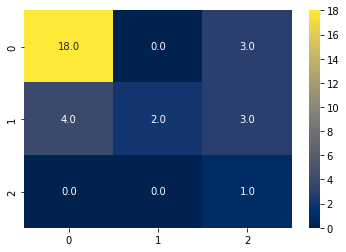

In [415]:
model_metrics(y_test, cb.predict(X_test_vectorizer), cb)

### **3.7.8. OVERALL MODEL METRICS**

In [454]:
metrics_detail = pd.DataFrame({
    'model' : ['Multinomial Naive Bayes','Gaussian Naive Bayes','Random Forest Classifier','AdaBoost Classifier','LGBM Classifier','XGBoost Classifier','CatBoost Classifier'],
    'cross_validation' : [cv_score_1, cv_score_2, cv_score_3, cv_score_4, cv_score_5, cv_score_6, cv_score_7],
    'precision' : [0.6774, 0.7742, 0.6452, 0.4839, 0.5484, 0.5484, 0.6774],
    'recall' : [0.6774, 0.7742, 0.6452, 0.4839, 0.5484, 0.5484, 0.6774],
    'f1_score' : [0.6774, 0.7742, 0.6452, 0.4839, 0.5484, 0.5484, 0.6774]
})

In [455]:
metrics_detail

,model,cross_validation,precision,recall,f1_score
0,Multinomial Naive Bayes,0.588506,0.6774,0.6774,0.6774
1,Gaussian Naive Bayes,0.660130,0.7742,0.7742,0.7742
2,Random Forest Classifier,0.617468,0.6452,0.6452,0.6452
3,AdaBoost Classifier,0.577597,0.4839,0.4839,0.4839
4,LGBM Classifier,0.621234,0.5484,0.5484,0.5484
5,XGBoost Classifier,0.686299,0.5484,0.5484,0.5484
6,CatBoost Classifier,0.704416,0.6774,0.6774,0.6774


Text(0.5, 1.0, 'PERBANDINGAN CROSS VALIDATION SETIAP MODEL')

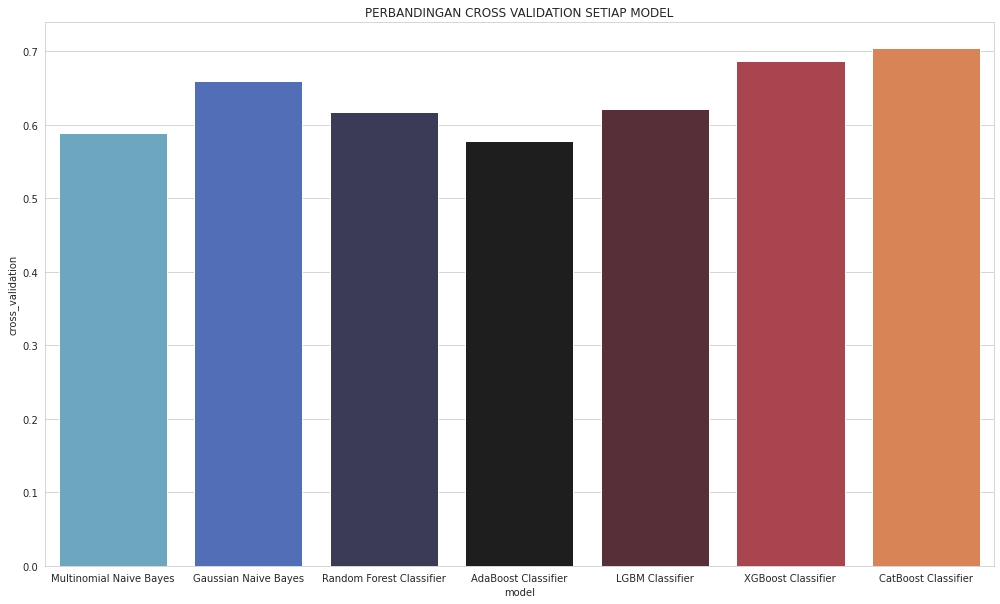

In [483]:
fig, ax = plt.subplots(figsize=(17,10))

sns.barplot(x=metrics_detail.model, y=metrics_detail.cross_validation, palette='icefire')
plt.title('PERBANDINGAN CROSS VALIDATION SETIAP MODEL')

Text(0.5, 1.0, 'PERBANDINGAN PRECISION SETIAP MODEL')

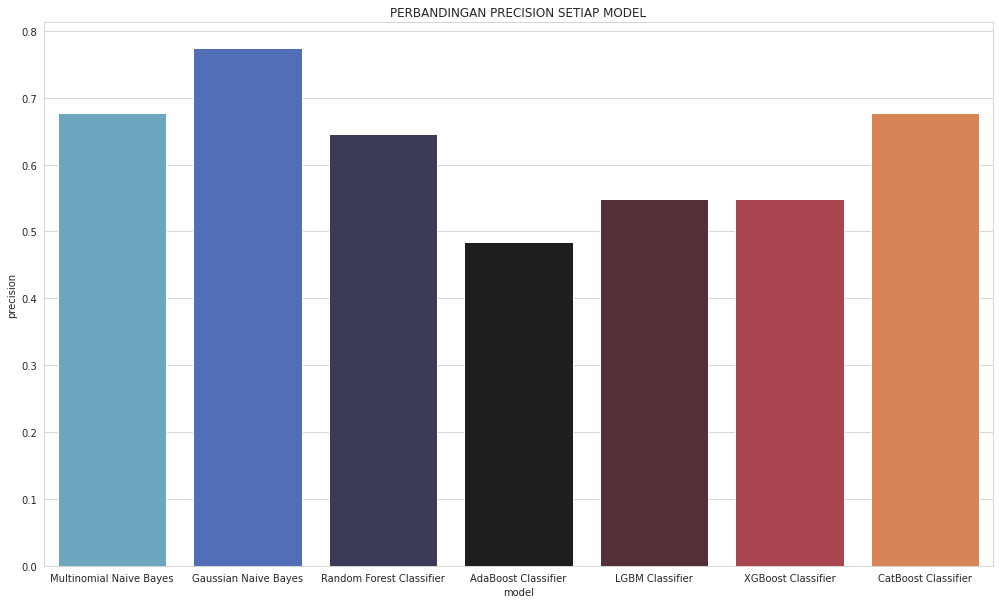

In [482]:
fig, ax = plt.subplots(figsize=(17,10))

sns.barplot(x=metrics_detail.model, y=metrics_detail.precision, palette='icefire')
plt.title('PERBANDINGAN PRECISION SETIAP MODEL')

Text(0.5, 1.0, 'PERBANDINGAN RECALL SETIAP MODEL')

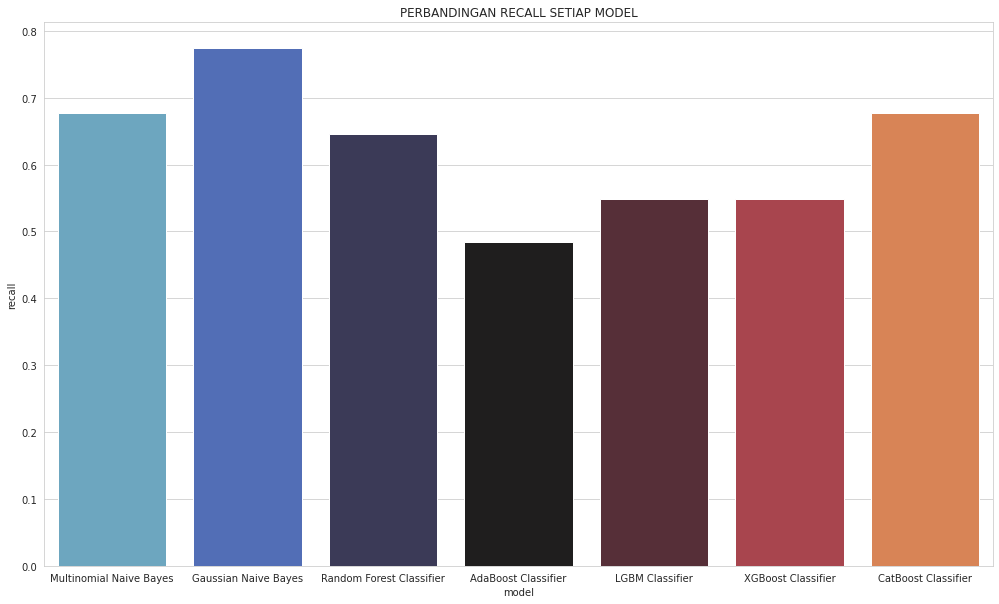

In [481]:
fig, ax = plt.subplots(figsize=(17,10))

sns.barplot(x=metrics_detail.model, y=metrics_detail.recall, palette='icefire')
plt.title('PERBANDINGAN RECALL SETIAP MODEL')

Text(0.5, 1.0, 'PERBANDINGAN F1-SCORE SETIAP MODEL')

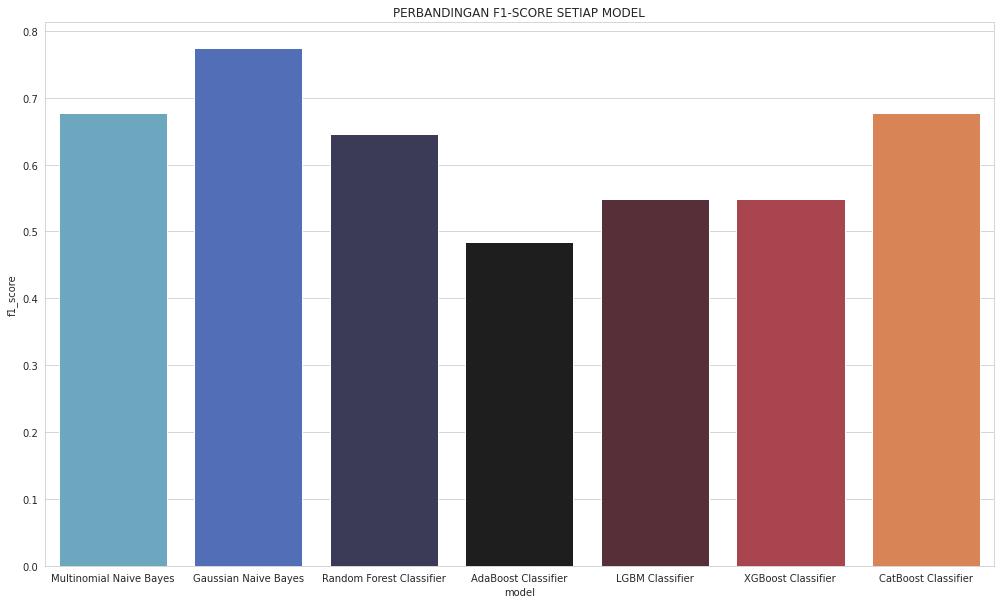

In [484]:
fig, ax = plt.subplots(figsize=(17,10))

sns.barplot(x=metrics_detail.model, y=metrics_detail.f1_score, palette='icefire')
plt.title('PERBANDINGAN F1-SCORE SETIAP MODEL')

## **3.8. WORDCLOUD**

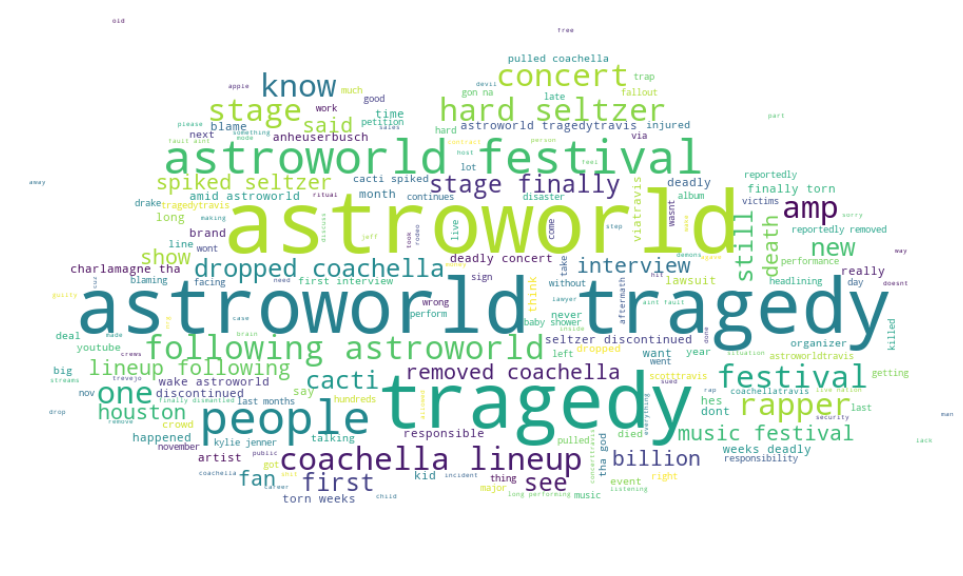

In [499]:
plt.figure(figsize=(17,17))
wordcloud(tweets_df)

# **4. FINAL MODEL: GAUSSIAN NAIVE BAYES**

Berdasarkan metrik pada bagian 3.7:
* 3 model dengan rata-rata *cross validation score* tertinggi adalah CatBoost Classifier, XGBoost Classifier, dan Gaussian Naive Bayes
* Pada metrik *precision*, *recall*, dan *f1-score*, Gaussian Naive Bayes memiliki nilai skor yang paling tinggi di antara 7 model yang ada.



**CAUTION** <br>
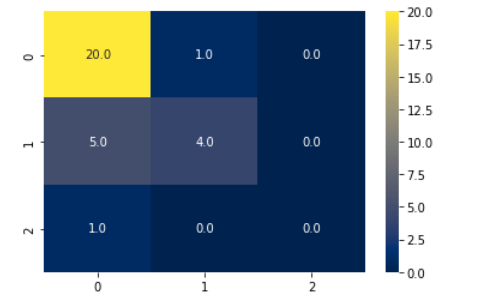

Akan tetapi, apabila dilihat dari *confusion matrix*, model hanya bisa memprediksi 4/9 kelas positif dan tidak bisa memprediksi kelas netral. Hal ini menunjukkan bahwa terjadi *overfitting* karena data dengan kelas negatif lebih dominan atau *class imbalance*. Untuk mengatasi keadaan ini, dapat diambil data lebih banyak lagi atau dilakukan *sampling* (*oversampling* atau *undersampling*)

**HASIL PREDIKSI MODEL PADA DATA TEST**

In [487]:
test['predicted_sentiment'] = gaussian_nb.predict(X_test_vectorizer.todense())
test

,text,sentiment,predicted_sentiment
306,isnt disgruntled travis scott showed us navy ship getting blown astroworld san diego guess also disgruntled really think kid capable wow,1,1
224,long headlining annual music festival,1,1
369,christmas miracle byeeeeee travis scott long performing coachella astroworld replaced new punk band vindicated kook,1,0
46,travis scott drake apple live nation facing new billion astroworld lawsuit via,0,0
367,im sorry still never understand astroworld deaths travis scotts fault like really got ta tell,0,0
204,wake numerous lawsuits following astroworld tragedy travis scott dropped coachella lineup hard seltzer cacti discontinued,0,0
290,travis scott sacrificial ritual truth via astroworld performance goes much deep meets eye relating portal openings deity channeling child sacrifice,1,1
125,travis scott cancelled rapper thrown coachella lineup astroworld tragedy,0,0
481,travis scott reportedly removed coachella lineup astroworld tragedy,0,0
171,travis scotts cacti spiked seltzer discontinued astroworld disaster,0,0
